# 9장: CycleGAN

<table align="left">
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/rickiepark/gans-in-action/blob/master/chapter-9/Chapter9_CycleGAN.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />구글 코랩에서 실행하기</a>
  </td>
</table>

이 코랩/주피터 노트북은 다음 순서대로 진행합니다:

1. 코랩이 기본으로 제공하지 않는 라이브러리를 설치합니다.
2. `%%bash` 매직 명령으로 apple2orange 데이터셋을 다운로드합니다.
3. 핵심 데이터 구조인 `DataLoader()` 클래스를 만듭니다.
4. 필요한 라이브러리를 모두 임포트합니다.
5. 다음 순서대로 CycleGAN을 정의합니다:

> 5.1 핵심 하이퍼파라미터와 초기화 메서드를 정의합니다.

> 5.2 생성자와 판별자를 재사용하기 위한 정적 메서드를 정의합니다.

> 5.3 생성자와 판별자를 만듭니다.

> 5.4 변환된 이미지를 샘플링하기 위한 헬퍼 함수를 정의합니다.

> 5.5 훈련 반복문을 정의합니다.

6. CycleGAN을 훈련하고 결과에 대해 이야기합니다!
--- 

In [1]:
%%bash

FILE=apple2orange
rm -rf ./datasets
mkdir ./datasets

URL=https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/$FILE.zip
ZIP_FILE=./datasets/$FILE.zip
TARGET_DIR=./datasets/$FILE/
wget -N $URL -O $ZIP_FILE
mkdir $TARGET_DIR
unzip $ZIP_FILE -d ./datasets/
rm $ZIP_FILE

mkdir -p ./images/$FILE/

Archive:  ./datasets/apple2orange.zip
   creating: ./datasets/apple2orange/trainA/
  inflating: ./datasets/apple2orange/trainA/n07740461_6908.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_7635.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_586.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_9813.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_6835.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_2818.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_2918.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_1213.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_2476.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_13596.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_4093.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_14738.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_6477.jpg  
  inflating: ./datasets/apple2orange/trainA/n07740461_11356.jpg  
  inf

for details.

--2021-08-22 15:55:35--  https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/apple2orange.zip
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.244.190
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.244.190|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 78456409 (75M) [application/zip]
Saving to: ‘./datasets/apple2orange.zip’

     0K .......... .......... .......... .......... ..........  0%  183K 6m59s
    50K .......... .......... .......... .......... ..........  0%  366K 5m14s
   100K .......... .......... .......... .......... ..........  0% 11.7M 3m31s
   150K .......... .......... .......... .......... ..........  0%  384K 3m28s
   200K .......... .......... .......... .......... ..........  0% 12.8M 2m48s
   250K .......... .......... .......... .......... ..........  0% 7.42M 2m21s
   300K .......... .......... .......... .......... ..........  0% 19.2M 2m2s
   350K .........

## DataLoader

아래에서 데이터를 담고 있는 핵심 객체를 정의하겠습니다. 이 객체로 다음을 수행할 수 있습니다:

1. `CycleGAN`의 `__init__` 메서드에서 정의한 데이터셋 이름으로 `load_data`에서 디스크 데이터를 로드합니다.
2. 훈련하는 동안 `load_batch` 메서드로 데이터를 로드합니다. 효율성을 높이기 위해 파이썬의 제너레이터로 만듭니다.
3. `load_data`에서 사용하는 `imread` 헬퍼 함수

In [2]:
import scipy
import imageio
from skimage.transform import resize
from glob import glob
import numpy as np

class DataLoader():
    def __init__(self, dataset_name, img_res=(128, 128)):
        self.dataset_name = dataset_name
        self.img_res = img_res

    def load_data(self, domain, batch_size=1, is_testing=False):
        data_type = "train%s" % domain if not is_testing else "test%s" % domain
        path = glob('./datasets/%s/%s/*' % (self.dataset_name, data_type))

        batch_images = np.random.choice(path, size=batch_size)

        imgs = []
        for img_path in batch_images:
            img = self.imread(img_path)
            if not is_testing:
                img = resize(img, self.img_res)

                if np.random.random() > 0.5:
                    img = np.fliplr(img)
            else:
                img = resize(img, self.img_res)
            imgs.append(img)

        imgs = np.array(imgs)/127.5 - 1.

        return imgs

    def load_batch(self, batch_size=1, is_testing=False):
        data_type = "train" if not is_testing else "val"
        path_A = glob('./datasets/%s/%sA/*' % (self.dataset_name, data_type))
        path_B = glob('./datasets/%s/%sB/*' % (self.dataset_name, data_type))

        self.n_batches = int(min(len(path_A), len(path_B)) / batch_size)
        total_samples = self.n_batches * batch_size

        # Sample n_batches * batch_size from each path list so that model sees all
        # samples from both domains
        path_A = np.random.choice(path_A, total_samples, replace=False)
        path_B = np.random.choice(path_B, total_samples, replace=False)

        for i in range(self.n_batches-1):
            batch_A = path_A[i*batch_size:(i+1)*batch_size]
            batch_B = path_B[i*batch_size:(i+1)*batch_size]
            imgs_A, imgs_B = [], []
            for img_A, img_B in zip(batch_A, batch_B):
                img_A = self.imread(img_A)
                img_B = self.imread(img_B)

                img_A = resize(img_A, self.img_res)
                img_B = resize(img_B, self.img_res)

                if not is_testing and np.random.random() > 0.5:
                        img_A = np.fliplr(img_A)
                        img_B = np.fliplr(img_B)

                imgs_A.append(img_A)
                imgs_B.append(img_B)

            imgs_A = np.array(imgs_A)/127.5 - 1.
            imgs_B = np.array(imgs_B)/127.5 - 1.

            yield imgs_A, imgs_B

    def imread(self, path):
        return imageio.imread(path, pilmode='RGB').astype(np.float)

## 라이브러리 임포트

In [3]:
from __future__ import print_function, division
import scipy
from tensorflow.keras.datasets import mnist
from tensorflow_addons.layers import InstanceNormalization
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout, Concatenate
from tensorflow.keras.layers import BatchNormalization, Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
import datetime
import matplotlib.pyplot as plt
import sys
import numpy as np
import os

## CycleGAN

1. 일부 파라미터를 정의합니다.
2. 판별자를 만들고 컴파일합니다.
3. 생성자를 만들고 컴파일합니다(조금 더 복잡합니다).

In [4]:
class CycleGAN():
    def __init__(self):
        # 입력 크기
        self.img_rows = 128
        self.img_cols = 128
        self.channels = 3
        self.img_shape = (self.img_rows, self.img_cols, self.channels)

        # 데이터 로더 설정
        self.dataset_name = 'apple2orange'
        # DataLoader 객체를 사용해 전처리된 데이터 임포트합니다.
        self.data_loader = DataLoader(dataset_name=self.dataset_name,
                                      img_res=(self.img_rows, self.img_cols))

        # D(PatchGAN)의 출력 크기를 계산합니다.
        patch = int(self.img_rows / 2**4)
        self.disc_patch = (patch, patch, 1)

        # G와 D의 첫 번째 층에 있는 필터의 개수
        self.gf = 32
        self.df = 64

        # 손실 가중치
        self.lambda_cycle = 10.0                    # 사이클-일관성 손실
        self.lambda_id = 0.9 * self.lambda_cycle    # 동일성 손실

        optimizer = Adam(0.0002, 0.5)
        
        # 판별자를 만들고 컴파일합니다.
        self.d_A = self.build_discriminator()
        self.d_B = self.build_discriminator()
        self.d_A.compile(loss='mse',
                         optimizer=optimizer,
                         metrics=['accuracy'])
        self.d_B.compile(loss='mse',
                         optimizer=optimizer,
                         metrics=['accuracy'])

        #-------------------------
        # 생성자의 계산 그래프를 만듭니다.
        #-------------------------

        # 생성자를 만듭니다.
        self.g_AB = self.build_generator()
        self.g_BA = self.build_generator()

        # 두 도메인의 입력 이미지
        img_A = Input(shape=self.img_shape)
        img_B = Input(shape=self.img_shape)

        # 이미지를 다른 도메인으로 변환합니다.
        fake_B = self.g_AB(img_A)
        fake_A = self.g_BA(img_B)
        # 원본 도메인으로 이미지를 다시 변환합니다.
        reconstr_A = self.g_BA(fake_B)
        reconstr_B = self.g_AB(fake_A)
        # 동일한 이미지 매핑
        img_A_id = self.g_BA(img_A)
        img_B_id = self.g_AB(img_B)

        # 연결 모델에서는 생성자만 훈련합니다.
        self.d_A.trainable = False
        self.d_B.trainable = False

        # 판별자가 변환된 이미지를 검증합니다.
        valid_A = self.d_A(fake_A)
        valid_B = self.d_B(fake_B)

        # 연결 모델은 판별자를 속이기 위한 생성자를 훈련합니다.
        self.combined = Model(inputs=[img_A, img_B],
                              outputs=[valid_A, valid_B,
                                       reconstr_A, reconstr_B,
                                       img_A_id, img_B_id])
        self.combined.compile(loss=['mse', 'mse',
                                    'mae', 'mae',
                                    'mae', 'mae'],
                              loss_weights=[1, 1,
                                            self.lambda_cycle, self.lambda_cycle,
                                            self.lambda_id, self.lambda_id],
                              optimizer=optimizer)

## 정적 메서드

두 가지를 유의하세요:

1. 이전 셀의 `CycleGAN` 클래스를 상속해 새로운 `CycleGAN` 클래스를 만듭니다. 교육적인 목적을 위해 여러 셀에 걸쳐 클래스를 정의하기 위해서 사용한 최선의 방법입니다. 좋은 방법이 아니라는 조엘 그루스(Joel Grus)의 의견에 동의하지만 노트북을 위해서 어쩔 수 없습니다.
2. `@staticmethod` 메서드를 사용해 25줄 정도 코드를 줄일 수 있습니다. 정적 메서드에 대해서는 [여기](https://stackoverflow.com/questions/136097/what-is-the-difference-between-staticmethod-and-classmethod)를 참고하세요. 생성자와 판별자를 간결하게 작성하기 위해서도 사용하겠습니다.

In [5]:
class CycleGAN(CycleGAN):
      @staticmethod
      def conv2d(layer_input, filters, f_size=4, normalization=True):
        """다운샘플링하는 동안 사용되는 층"""
        d = Conv2D(filters, kernel_size=f_size,
                   strides=2, padding='same')(layer_input)
        d = LeakyReLU(alpha=0.2)(d)
        if normalization:
            d = InstanceNormalization()(d)
        return d
      
      @staticmethod
      def deconv2d(layer_input, skip_input, filters, f_size=4, dropout_rate=0):
            """업샘플링하는 동안 사용되는 층"""
            u = UpSampling2D(size=2)(layer_input)
            u = Conv2D(filters, kernel_size=f_size, strides=1,
                       padding='same', activation='relu')(u)
            if dropout_rate:
                u = Dropout(dropout_rate)(u)
            u = InstanceNormalization()(u)
            u = Concatenate()([u, skip_input])
            return u

## 생성자

In [6]:
class CycleGAN(CycleGAN):
    def build_generator(self):
        """U-Net 생성자"""
        # 이미지 입력
        d0 = Input(shape=self.img_shape)

        # 다운샘플링
        d1 = self.conv2d(d0, self.gf)
        d2 = self.conv2d(d1, self.gf * 2)
        d3 = self.conv2d(d2, self.gf * 4)
        d4 = self.conv2d(d3, self.gf * 8)

        # 업샘플링
        u1 = self.deconv2d(d4, d3, self.gf * 4)
        u2 = self.deconv2d(u1, d2, self.gf * 2)
        u3 = self.deconv2d(u2, d1, self.gf)

        u4 = UpSampling2D(size=2)(u3)
        output_img = Conv2D(self.channels, kernel_size=4,
                            strides=1, padding='same', activation='tanh')(u4)

        return Model(d0, output_img)

## 판별자

In [7]:
class CycleGAN(CycleGAN):
    def build_discriminator(self):
      img = Input(shape=self.img_shape)

      d1 = self.conv2d(img, self.df, normalization=False)
      d2 = self.conv2d(d1, self.df * 2)
      d3 = self.conv2d(d2, self.df * 4)
      d4 = self.conv2d(d3, self.df * 8)

      validity = Conv2D(1, kernel_size=4, strides=1, padding='same')(d4)

      return Model(img, validity)

## 샘플링 함수

책에 실린 출력을 만듭니다. 변환된 이미지를 얻기 위해 테스트 또는 평가 모드에서 실행해야 합니다.

전체 사이클은 다음과 같습니다:

$ A -> \hat B -> \hat A$

또한 다음과 같습니다:

$ B -> \hat A -> \hat B$

In [8]:
class CycleGAN(CycleGAN):
      def sample_images(self, epoch, batch_i):
        r, c = 2, 3

        imgs_A = self.data_loader.load_data(domain="A", batch_size=1, is_testing=True)
        imgs_B = self.data_loader.load_data(domain="B", batch_size=1, is_testing=True)
        
        # 이미지를 다른 도메인으로 변환합니다.
        fake_B = self.g_AB.predict(imgs_A)
        fake_A = self.g_BA.predict(imgs_B)
        # 원본 도메인으로 되돌립니다.
        reconstr_A = self.g_BA.predict(fake_B)
        reconstr_B = self.g_AB.predict(fake_A)

        gen_imgs = np.concatenate([imgs_A, fake_B, reconstr_A, imgs_B, fake_A, reconstr_B])

        # 이미지를 0 - 1 사이로 스케일을 바꿉니다.
        gen_imgs = 0.5 * gen_imgs + 0.5

        titles = ['Original', 'Translated', 'Reconstructed']
        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow(gen_imgs[cnt])
                axs[i, j].set_title(titles[j])
                axs[i,j].axis('off')
                cnt += 1
        fig.savefig("images/%s/%d_%d.png" % (self.dataset_name, epoch, batch_i))
        plt.show()

## 반복 루프

진짜 마법이 일어나는 부분입니다.

In [9]:
class CycleGAN(CycleGAN):
      def train(self, epochs, batch_size=1, sample_interval=50):
        # 적대 손실에 대한 정답
        valid = np.ones((batch_size,) + self.disc_patch)
        fake = np.zeros((batch_size,) + self.disc_patch)


        for epoch in range(epochs):
            for batch_i, (imgs_A, imgs_B) in enumerate(self.data_loader.load_batch(batch_size)):

                # ----------------------
                #  판별자 훈련
                # ----------------------

                # 이미지를 상대 도메인으로 변환합니다.
                fake_B = self.g_AB.predict(imgs_A)
                fake_A = self.g_BA.predict(imgs_B)

                # 판별자를 훈련합니다. (원본 이미지 = real / 변환된 이미지 = fake)
                dA_loss_real = self.d_A.train_on_batch(imgs_A, valid)
                dA_loss_fake = self.d_A.train_on_batch(fake_A, fake)
                dA_loss = 0.5 * np.add(dA_loss_real, dA_loss_fake)

                dB_loss_real = self.d_B.train_on_batch(imgs_B, valid)
                dB_loss_fake = self.d_B.train_on_batch(fake_B, fake)
                dB_loss = 0.5 * np.add(dB_loss_real, dB_loss_fake)

                # 판별자 전체 손실
                d_loss = 0.5 * np.add(dA_loss, dB_loss)

                # ------------------
                #  생성자 훈련
                # ------------------

                # 생성자를 훈련합니다.
                g_loss = self.combined.train_on_batch([imgs_A, imgs_B],
                                                      [valid, valid,
                                                       imgs_A, imgs_B,
                                                       imgs_A, imgs_B])
                # save_interval 마다 생성된 이미지 샘플을 저장합니다.
                if batch_i % sample_interval == 0:
                    self.sample_images(epoch, batch_i)

## CycleGAN 훈련

클래스로 만들었기 때문에 CycleGAN 객체를 만들고 `train` 메서드를 실행해야 합니다.

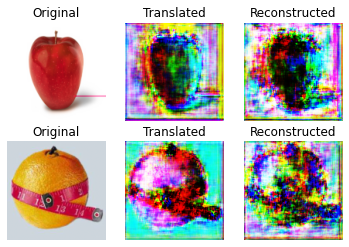

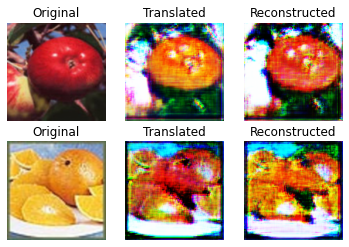

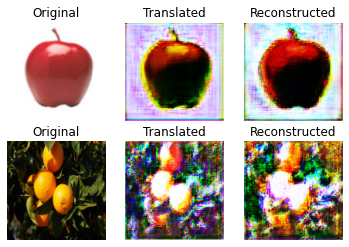

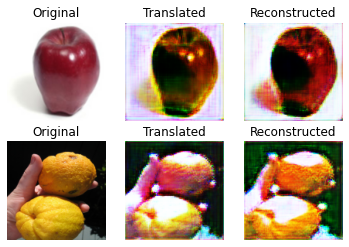

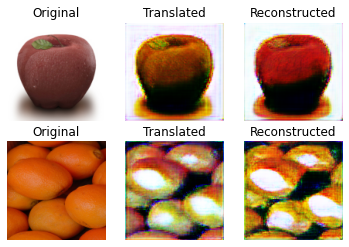

...

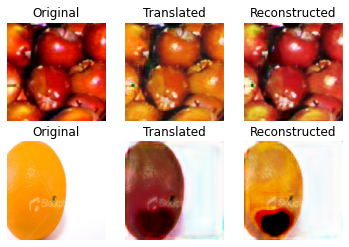

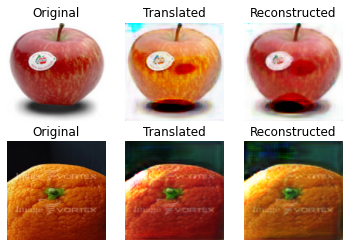

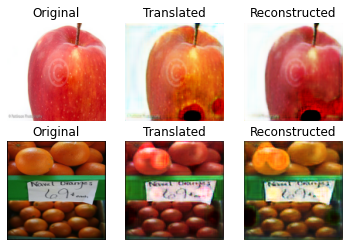

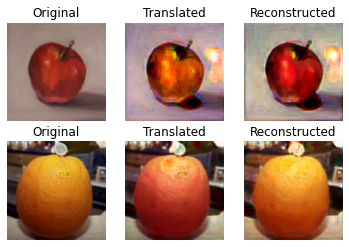

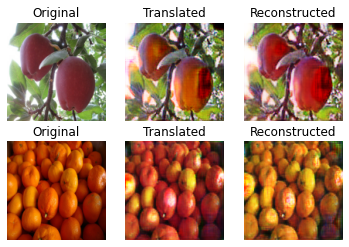

In [10]:
cycle_gan = CycleGAN()
cycle_gan.train(epochs=100, batch_size=64, sample_interval=10)

## 결과를 확인해 보겠습니다!

3가지 면을 고찰할 수 있습니다:
1. CPU나 코랩 GPU에서도 느립니다.
2. 처음 이미지는 품질이 나쁘고 알아볼 수 없습니다. 하지만 곧 괜찮은 재구성 이미지를 만듭니다.
3. 후반부 재구성의 품질은 혼재되어 있습니다. 어떤 것은 아래 그림처럼 매우 뚜렷합니다. 하지만 어떤 것은 단순히 오렌지를 사과로 채색하거나 그 반대인 것 같습니다. 논문의 저자도 이 문제를 언급했습니다. CycleGAN은 근본적으로 이미지 구조를 바꿀 수 없고 단지 스타일을 바꿉니다. 이 제약 사항을 유념하세요.

![Good examples](https://i.ibb.co/n00BW1F/163-10.png)

또한 이는 GAN 연구자와 기술자의 현실을 잘 보여줍니다. 화려한 결과 대부분은 좋은 것을 골라낸 것일 수 있습니다. 대부분 논문은 실패 케이스를 공유하지 않습니다. [BigGAN](https://arxiv.org/abs/1809.11096)은 예외입니다. BigGAN의 성능이 현재(20/11/2018) 최고입니다. 심지어 [구글 드라이브로 샘플 폴더도 공개했습니다](https://drive.google.com/drive/folders/1SRYj8Ou1JZ4e09LqeawDHcUvoeY78tPO).